In [1]:

import pandas as pd

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

from sklearn.feature_extraction.text import TfidfVectorizer
import spacy

# TruncatedSVD from sklearn
from sklearn.decomposition import TruncatedSVD

from sklearn.cluster import DBSCAN

# EDA

Let's open the dataset and see what it looks like and if there are missing data

In [166]:
dataset = pd.read_csv("sample-data.csv")
dataset.head()

,id,description
0,1,Active classic boxers - There's a reason why o...
1,2,Active sport boxer briefs - Skinning up Glory ...
2,3,Active sport briefs - These superbreathable no...
3,4,"Alpine guide pants - Skin in, climb ice, switc..."
4,5,"Alpine wind jkt - On high ridges, steep ice an..."


In [3]:
dataset.isna().sum()
#no missing data

id             0
description    0
dtype: int64

In [4]:
dataset.shape


(500, 2)

In [5]:
#Let's have a look at one description
dataset.loc[0,"description"]

'Active classic boxers - There\'s a reason why our boxers are a cult favorite - they keep their cool, especially in sticky situations. The quick-drying, lightweight underwear takes up minimal space in a travel pack. An exposed, brushed waistband offers next-to-skin softness, five-panel construction with a traditional boxer back for a classic fit, and a functional fly. Made of 3.7-oz 100% recycled polyester with moisture-wicking performance. Inseam (size M) is 4 1/2". Recyclable through the Common Threads Recycling Program.<br><br><b>Details:</b><ul> <li>"Silky Capilene 1 fabric is ultralight, breathable and quick-to-dry"</li> <li>"Exposed, brushed elastic waistband for comfort"</li> <li>5-panel construction with traditional boxer back</li> <li>"Inseam (size M) is 4 1/2"""</li></ul><br><br><b>Fabric: </b>3.7-oz 100% all-recycled polyester with Gladiodor natural odor control for the garment. Recyclable through the Common Threads Recycling Program<br><br><b>Weight: </b>99 g (3.5 oz)<br><b

Overall, the dataset is pretty straigh forward
- 500 lines
- No missing data
- 2 columns : id and description

Let's start the text preprocessing to be able to cluster the item together

# Preprocessing

For the preprocessing, we will use the standard setup
- clean the text by removing punctuation and lowering the case
- text tokenization
- removal of stop words

In [167]:
# Importing english
import en_core_web_sm
nlp = en_core_web_sm.load()

In [168]:
#Let's clean the text by removing punctuation and lowering the case
dataset['clean_description'] = dataset['description'].str.replace(r"[^A-Za-z0-9 ]+", " ", regex = True)
dataset['clean_description']  = dataset['clean_description'].apply(lambda x: x.lower())
dataset.head()

,id,description,clean_description
0,1,Active classic boxers - There's a reason why o...,active classic boxers there s a reason why o...
1,2,Active sport boxer briefs - Skinning up Glory ...,active sport boxer briefs skinning up glory ...
2,3,Active sport briefs - These superbreathable no...,active sport briefs these superbreathable no...
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...


In [169]:
from spacy.lang.en.stop_words import STOP_WORDS

#tokenization
tokenized_doc = dataset['clean_description'].fillna(' ').apply(lambda x: nlp(x))
tokenized_doc

0      (active, classic, boxers,   , there, s, a, rea...
1      (active, sport, boxer, briefs,   , skinning, u...
2      (active, sport, briefs,   , these, superbreath...
3      (alpine, guide, pants,   , skin, in,  , climb,...
4      (alpine, wind, jkt,   , on, high, ridges,  , s...
                             ...                        
495    (cap, 2, bottoms,   , cut, loose, from, the, m...
496    (cap, 2, crew,   , this, crew, takes, the, edg...
497    (all, time, shell,   , no, need, to, use, that...
498    (all, wear, cargo, shorts,   , all, wear, carg...
499    (all, wear, shorts,   , time, to, simplify,  ,...
Name: clean_description, Length: 500, dtype: object

In [170]:
#remove stop words
tokenized_doc = tokenized_doc.apply(lambda doc: [token.lemma_ for token in doc if token.text not in STOP_WORDS])
tokenized_doc

0      [active, classic, boxer,   , s, reason, boxer,...
1      [active, sport, boxer, brief,   , skin, glory,...
2      [active, sport, brief,   , superbreathable, fl...
3      [alpine, guide, pant,   , skin,  , climb, ice,...
4      [alpine, wind, jkt,   , high, ridge,  , steep,...
                             ...                        
495    [cap, 2, bottom,   , cut, loose, madden, crowd...
496    [cap, 2, crew,   , crew, take, edge, fickle, w...
497    [time, shell,   , need, use, morning, time, um...
498    [wear, cargo, short,   , wear, cargo, short, b...
499    [wear, short,   , time, simplify,  , wear, sho...
Name: clean_description, Length: 500, dtype: object

In [171]:
# add a clean token column 
dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]
dataset.head()

,id,description,clean_description,clean_token
0,1,Active classic boxers - There's a reason why o...,active classic boxers there s a reason why o...,active classic boxer s reason boxer cult fa...
1,2,Active sport boxer briefs - Skinning up Glory ...,active sport boxer briefs skinning up glory ...,active sport boxer brief skin glory require...
2,3,Active sport briefs - These superbreathable no...,active sport briefs these superbreathable no...,active sport brief superbreathable fly brie...
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch...
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpi...


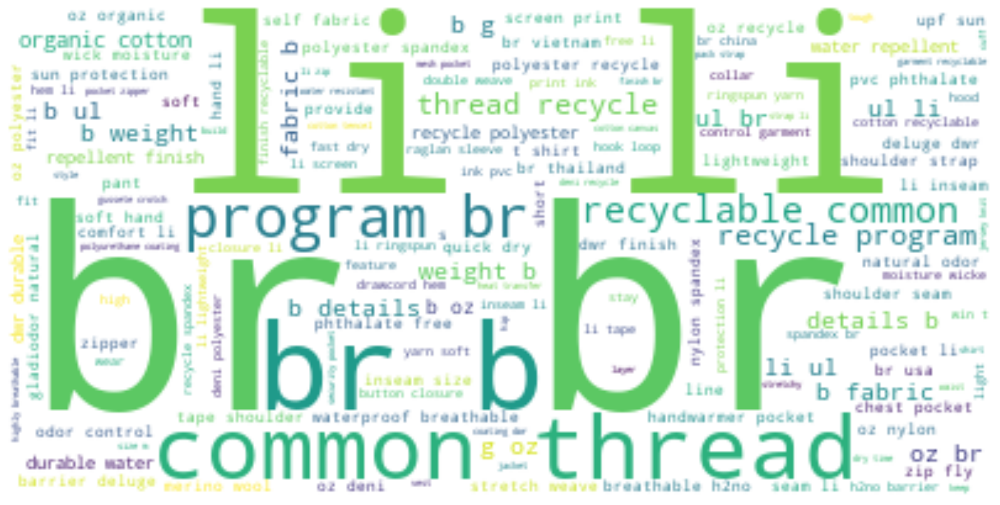

In [100]:
# Import necessary libraries
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import wordcloud
import pandas as pd

# Sample dataset for demonstration (remove this line if you already have a dataset)
# dataset = pd.DataFrame({"clean_token": ["example text here"]})

# Instantiate WordCloud
wd = wordcloud.WordCloud(background_color="white", contour_width=1, contour_color='steelblue')

# Join all text data into one string
all_text = " ".join(dataset["clean_token"])

# Generate the word cloud
cloud = wd.generate(all_text)

# Show plot
plt.figure(figsize=(20, 20))
plt.imshow(cloud, interpolation='bilinear')
plt.axis("off")
plt.show()


It seems we need to add some words to the spotwords list to remove the common word 

To remove the most common we will
- create a corpus with all the works of the clean text
- check the output format
- Use a NLP model on the corpus
- create a list of lemmatied tokens 
- check the text that are appearing more than 200 times and add them as stop words

In [172]:
# Join all words to create a corpus
corpus = ' '.join(dataset['clean_token'].astype(str))
type(corpus)



str

In [173]:
doc = nlp(corpus)


In [174]:
# Create lemmatization 
lemma = [token.lemma_ for token in doc if token.lemma_ not in STOP_WORDS]

# Create a DataFrame of lemmatized token
lemmadf = pd.Series(lemma)

# Create a mask of all counted values greater than 1000
common = lemmadf.value_counts()>800

# Apply mask
common = common[common]

common.shape

(10,)

In [175]:
#Here is an overview of the most comming text
common

           True
li         True
           True
br         True
b          True
oz         True
recycle    True
ul         True
fabric     True
pocket     True
Name: count, dtype: bool

In [176]:
# Update stop words 
new_stop_words = common.index

# Create a union of sets 
STOP_WORDS_updated = STOP_WORDS.union(new_stop_words)

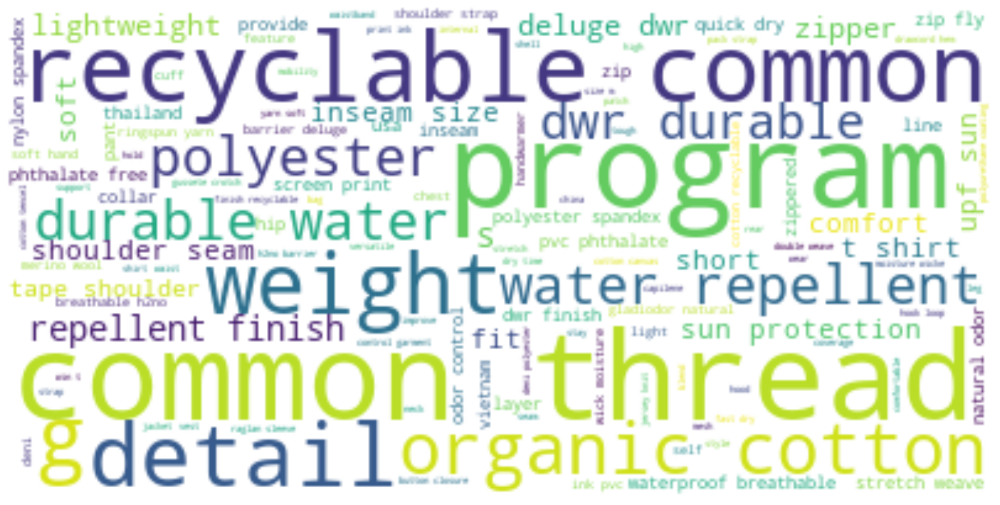

In [110]:
# Import necessary libraries
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import wordcloud
import pandas as pd


# Instantiate WordCloud
wd = wordcloud.WordCloud(background_color="white", contour_width=1, contour_color='steelblue', stopwords=STOP_WORDS_updated)

# Join all text data into one string
all_text = " ".join(dataset["clean_token"])

# Generate the word cloud
cloud = wd.generate(all_text)

# Show plot
plt.figure(figsize=(20, 20))
plt.imshow(cloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# Clustering

Now that we remove the useless words, let's try to clusterize the dataset

For this we will
- create the TF_IDF vector to get the most important words per description
- Used DBScan to create cluster based on the TF_IDF columns
- Loop on epsilon on min samples to get the best parameters
- The optimal parameters is manually selected to get the minimimum number of cluster without have too many outliers

In [177]:
from sklearn.feature_extraction import text 

#Customer creation of stop words including the most common words of the dataset
stop_words = text.ENGLISH_STOP_WORDS.union(common.index)

#Update of the clean token column to remove the additional spot words
tokenized_doc = dataset['clean_description'].fillna(' ').apply(lambda x: nlp(x))
tokenized_doc = tokenized_doc.apply(lambda doc: [token.lemma_ for token in doc if token.text not in stop_words])
dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]


In [178]:
# Tfidf transformer 
from sklearn.feature_extraction.text import TfidfVectorizer

# TF-IDF vector
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(dataset['clean_token'])

# X is a generator. We can transform that as an array
dense = X.toarray()
dense

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [179]:
eps = [0.57, 0.6, 0.62 ,0.63, 0.64, 0.65,0.68,0.69,0.70,0.72]
min_sample = [2,3,4]

for e in eps:
    for m in min_sample:
        print("---------------")
        print('epsilon : {} - min sample - {}'.format(e,m))
        dbscan = DBSCAN(eps=e, min_samples=m,metric='cosine')
        dbscan.fit(X)
        print("Number of clusters")
        print(np.unique(dbscan.labels_))

        dataset["Cluster_DBScan"] = dbscan.labels_
        dataset[dataset["Cluster_DBScan"]!=-1].head()
        print("Number of outliers")
        print(dataset[dataset['Cluster_DBScan']==-1].shape[0])
        print("---------------")

---------------
epsilon : 0.57 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46
 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70
 71 72 73 74 75 76 77 78 79 80 81 82]
Number of outliers
99
---------------
---------------
epsilon : 0.57 - min sample - 3
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37]
Number of outliers
189
---------------
---------------
epsilon : 0.57 - min sample - 4
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31]
Number of outliers
210
---------------
---------------
epsilon : 0.6 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 4

With epsilon equal to  0.7 and min sample to 3, we ends up with a good compromise with 16  clusters and 32 outliers

Now : 
- let's calculate the cluster based on the optimal parameters
- bring the clusters back in the dataset
- Loop on each clusters to get create the world cloud for all of them

In [185]:
dbscan = DBSCAN(eps=0.7, min_samples=3,metric='cosine')
dbscan.fit(X)

DBSCAN(eps=0.7, metric='cosine', min_samples=3)

In [186]:
dataset["Cluster_DBScan"] = dbscan.labels_
dataset.head()

,id,description,clean_description,clean_token,Cluster_DBScan
0,1,Active classic boxers - There's a reason why o...,active classic boxers there s a reason why o...,active classic boxer s reason boxer cult favor...,0
1,2,Active sport boxer briefs - Skinning up Glory ...,active sport boxer briefs skinning up glory ...,active sport boxer brief skin glory require mo...,0
2,3,Active sport briefs - These superbreathable no...,active sport briefs these superbreathable no...,active sport brief superbreathable fly brief m...,0
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch ro...,1
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpine ...,1


----------------
Cluster #0


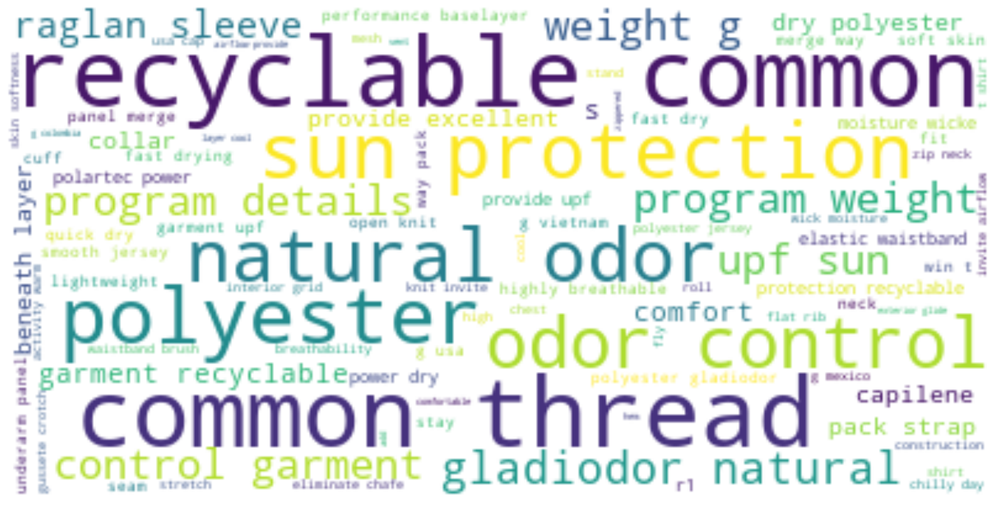

----------------
Cluster #1


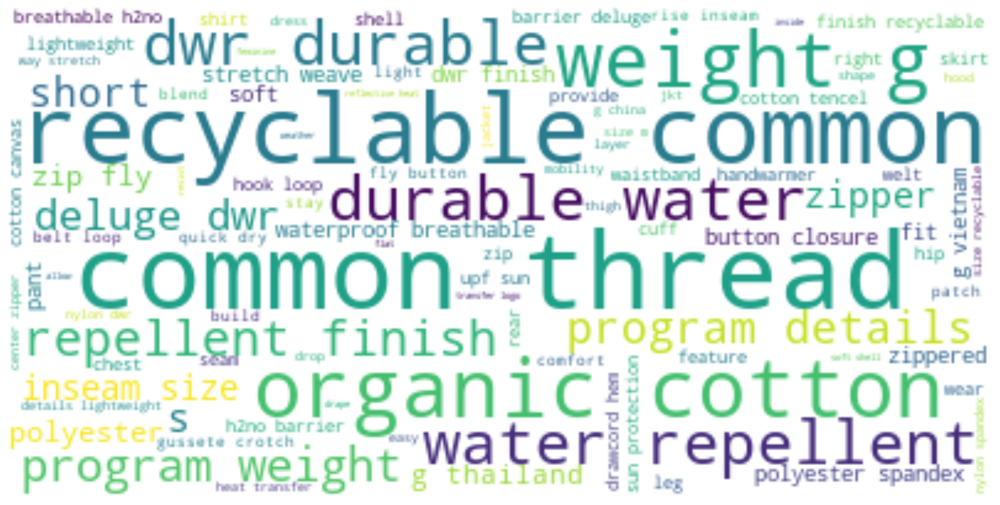

----------------
Cluster #2


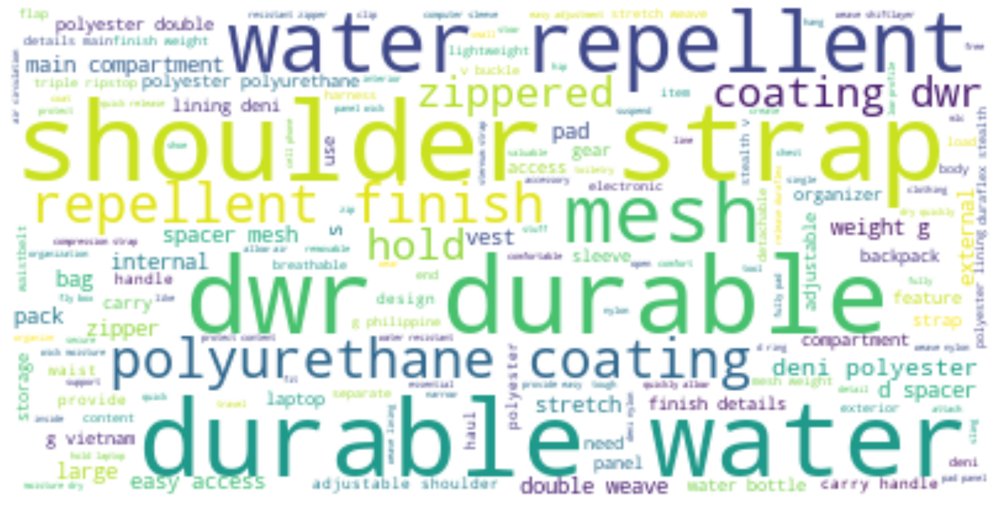

----------------
Cluster #3


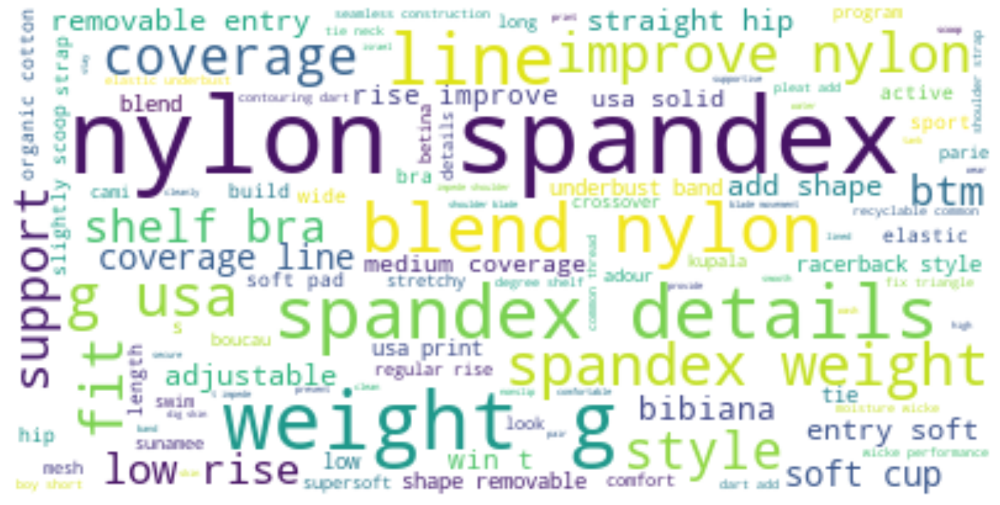

----------------
Cluster #4


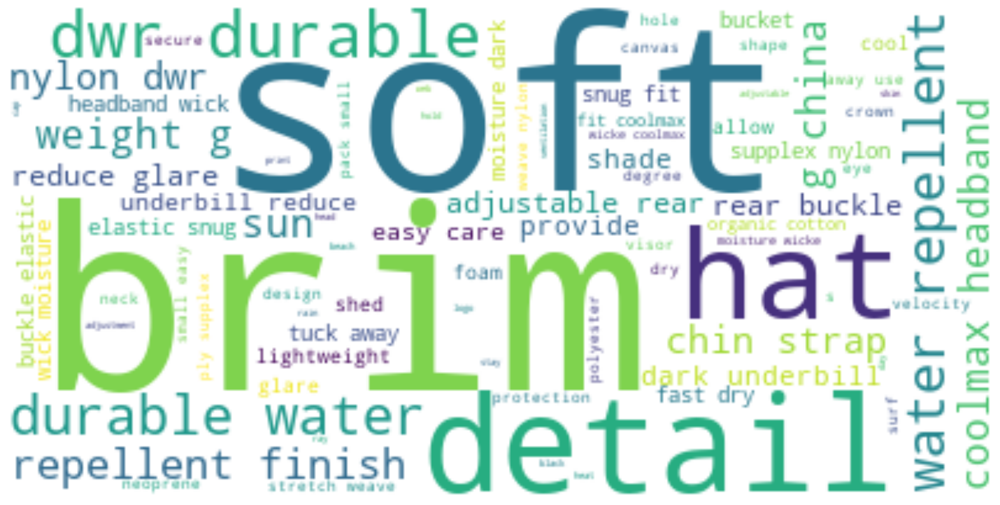

----------------
Cluster #5


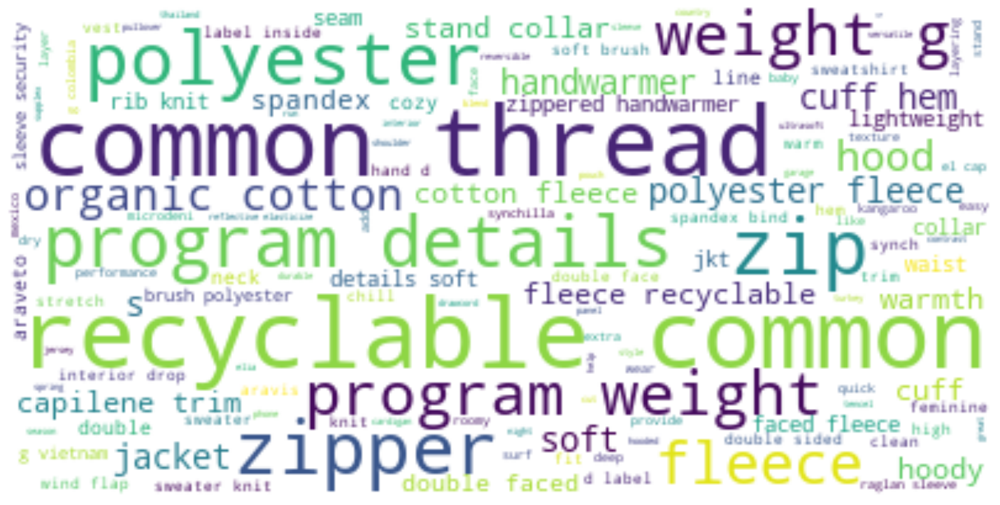

----------------
Cluster #6


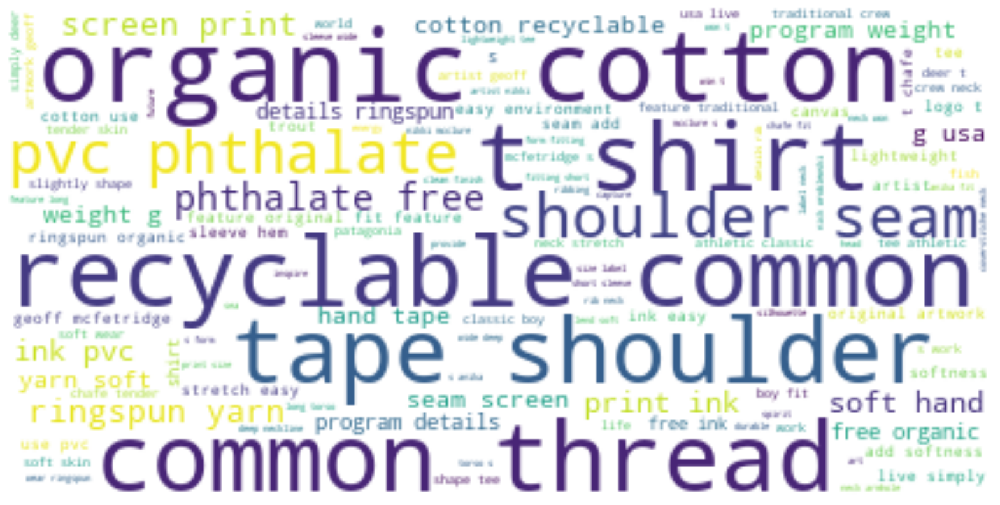

----------------
Cluster #7


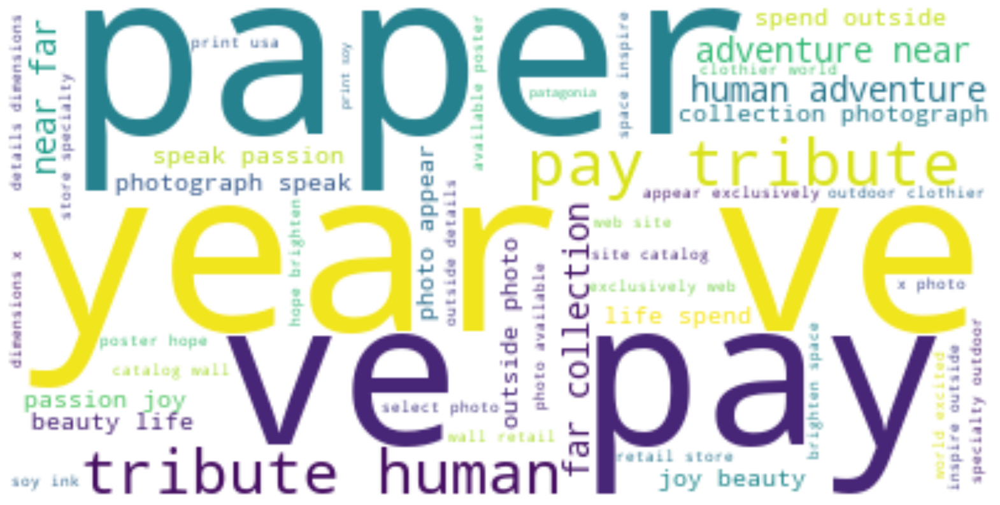

----------------
Cluster #8


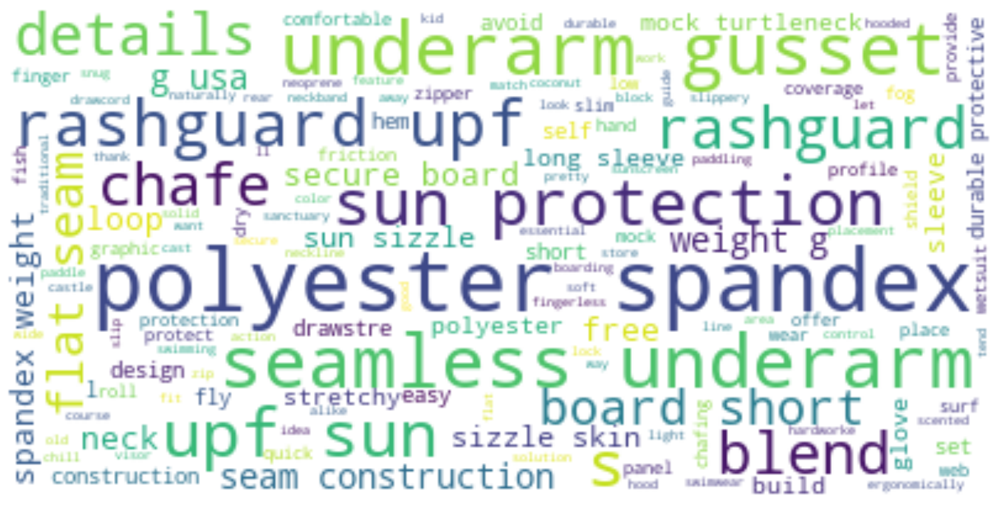

----------------
Cluster #9


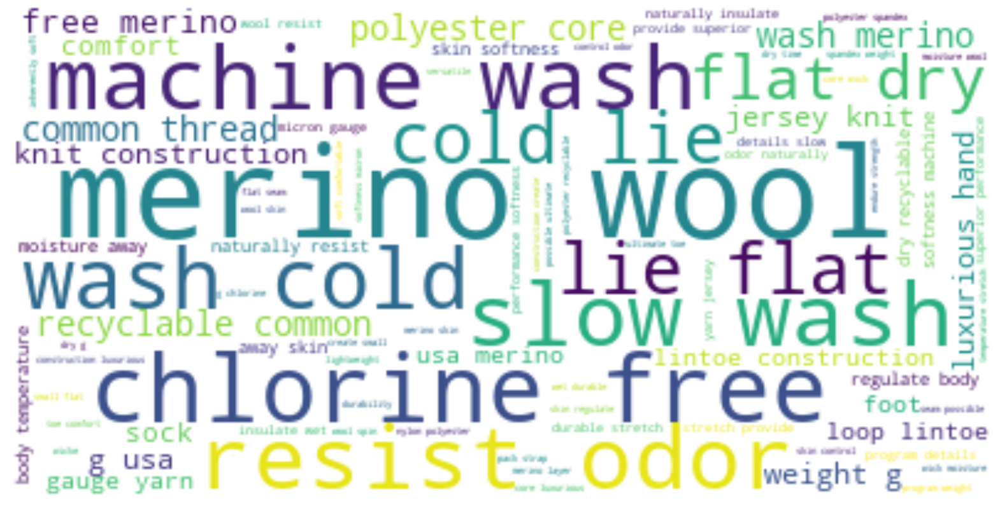

----------------
Cluster #10


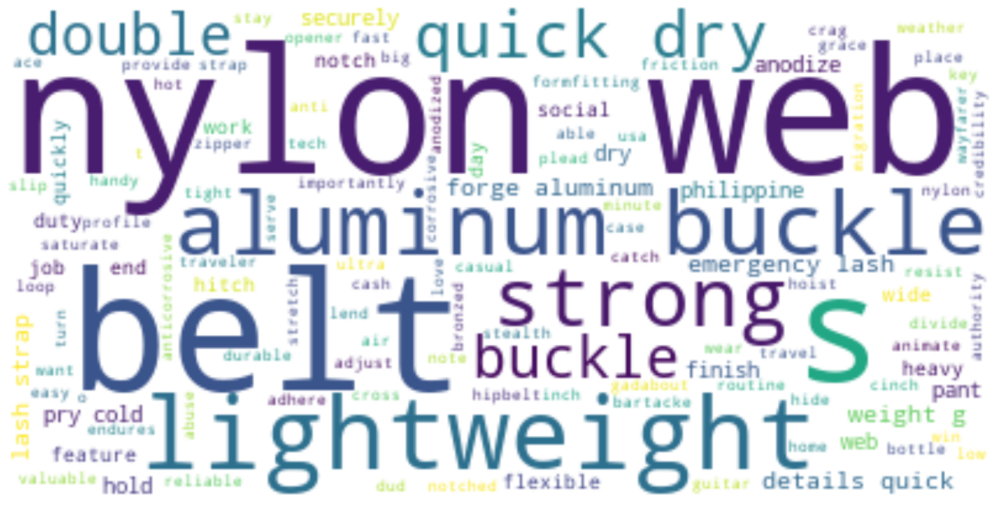

----------------
Cluster #11


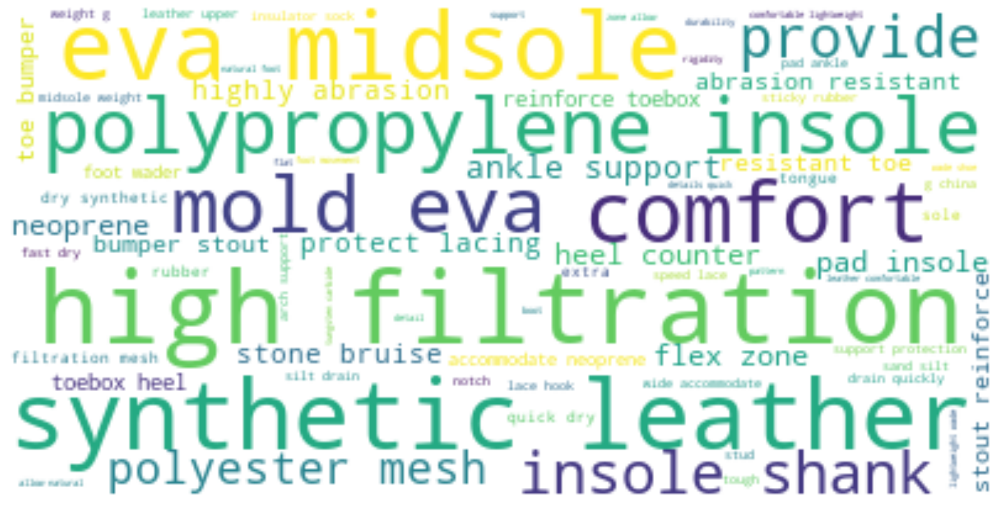

----------------
Cluster #12


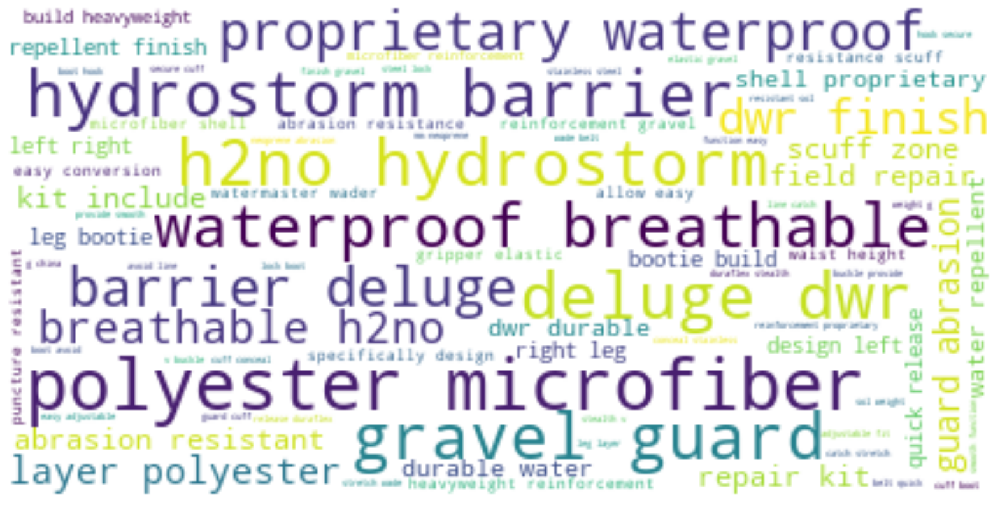

----------------
Cluster #13


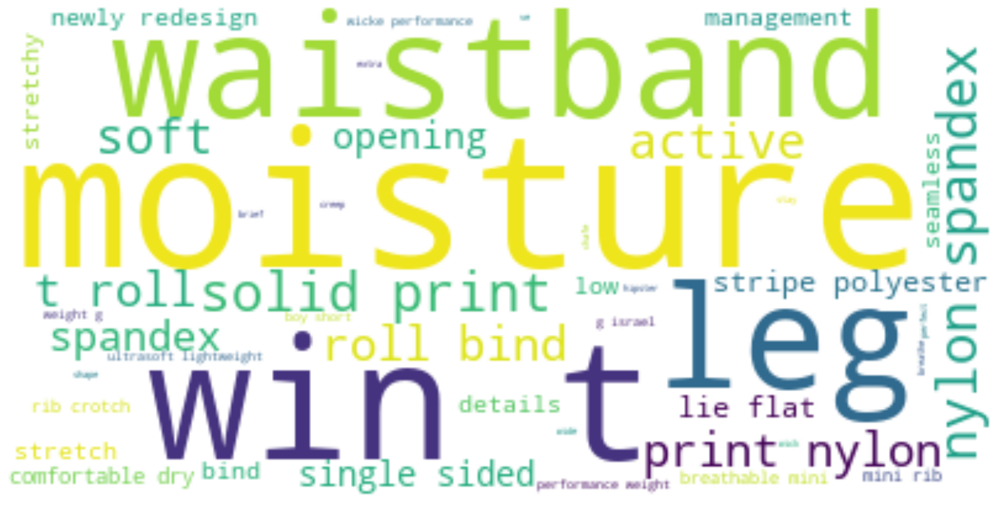

----------------
Cluster #14


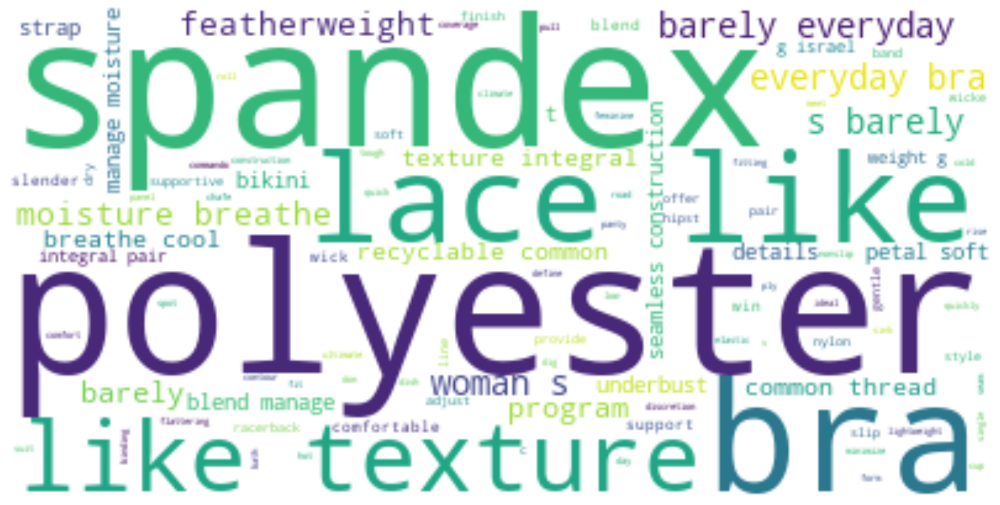

----------------
Cluster #15


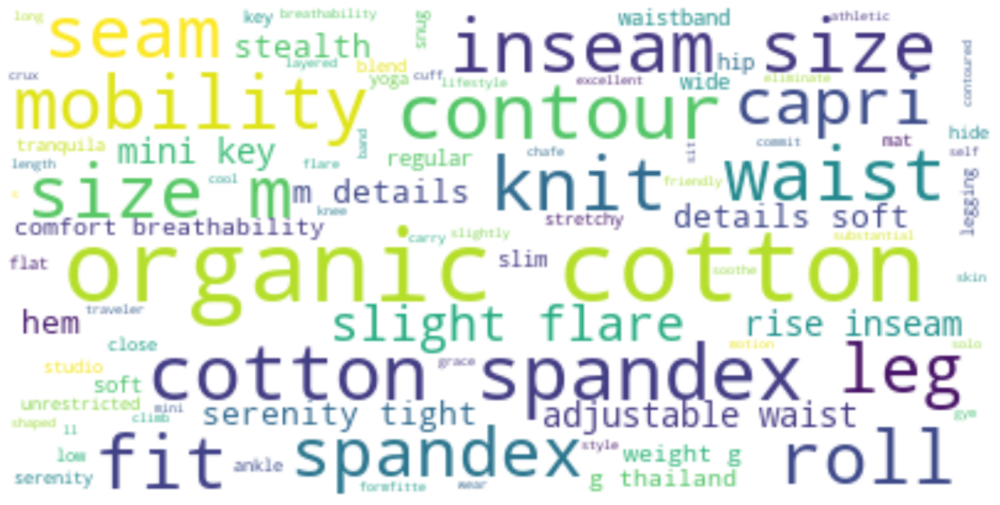

----------------
Cluster #16


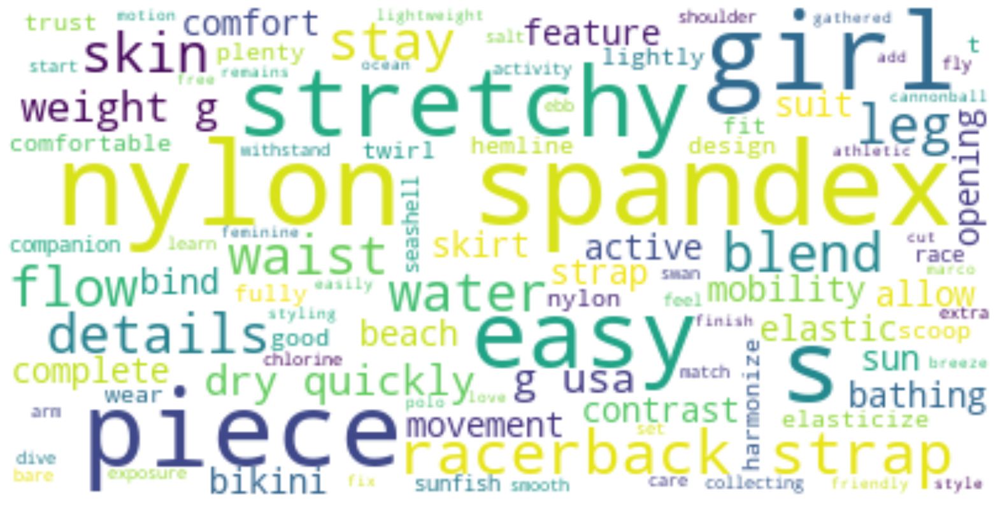

In [187]:
dataset_wo_cluster = dataset[dataset['Cluster_DBScan']!=-1]

# Instantiate WordCloud
wd = wordcloud.WordCloud(background_color="white", contour_width=1, contour_color='steelblue', stopwords=STOP_WORDS_updated)

list_cluster = dataset_wo_cluster["Cluster_DBScan"].unique()

for i in list_cluster :
    # Join all text data into one string
    all_text = " ".join(dataset_wo_cluster[dataset_wo_cluster["Cluster_DBScan"]==i]["clean_token"])

    # Generate the word cloud
    cloud = wd.generate(all_text)

    print("----------------")
    print('Cluster #{}'.format(list_cluster [i]))

    # Show plot
    plt.figure(figsize=(20, 20))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [188]:
#Here is an onverview of the number of item per clusters. High number ends up in the cluster 1
dataset['Cluster_DBScan'].value_counts()

Cluster_DBScan
 1     193
 0      65
 6      58
-1      32
 2      29
 9      24
 3      22
 5      22
 4      10
 7       8
 12      7
 8       7
 11      5
 10      4
 14      4
 15      4
 13      3
 16      3
Name: count, dtype: int64

In [189]:
#The dataset 0 is relatively generic as it includes lots of different type of clothes. Let's see if we can create sub-cluster inside it
dataset[dataset['Cluster_DBScan']==1]

,id,description,clean_description,clean_token,Cluster_DBScan
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch ro...,1
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpine ...,1
5,6,Ascensionist jkt - Our most technical soft she...,ascensionist jkt our most technical soft she...,ascensionist jkt technical soft shell mountain...,1
8,9,Baby micro d-luxe cardigan - Micro D-Luxe is a...,baby micro d luxe cardigan micro d luxe is a...,baby micro d luxe cardigan micro d luxe heaven...,1
11,12,"Baggies shorts - Even Baggies, our most popula...",baggies shorts even baggies our most popula...,baggies short baggie popular short occas...,1
...,...,...,...,...,...
483,484,Borderless trek pants - The Ruby Crest trail r...,borderless trek pants the ruby crest trail r...,borderless trek pant ruby crest trail run dire...,1
484,485,Borderless trek zip-off pants - Made for techn...,borderless trek zip off pants made for techn...,borderless trek zip pant technical performance...,1
497,498,All-time shell - No need to use that morning T...,all time shell no need to use that morning t...,time shell need use morning time umbrella ti...,1
498,499,All-wear cargo shorts - All-Wear Cargo Shorts ...,all wear cargo shorts all wear cargo shorts ...,wear cargo short wear cargo short bask glory s...,1


In [190]:
#Let's see if we can take the cluster 0 and remove stop words to be able to create cluster inside this cluster
sub_dataset = dataset[dataset['Cluster_DBScan']==1]


In [193]:
# Join all words to create a corpus
corpus = ' '.join(sub_dataset['clean_token'].astype(str))
type(corpus)

doc = nlp(corpus)


# Create lemmatization 
lemma = [token.lemma_ for token in doc if token.lemma_ not in stop_words]

# Create a DataFrame of lemmatized token
lemmadf = pd.Series(lemma)

# Create a mask of all counted values greater than 200 
sub_common = lemmadf.value_counts()>200

# Apply mask
sub_common = sub_common[sub_common]

sub_common.shape

(15,)

In [194]:
sub_common

recyclable    True
thread        True
common        True
program       True
zipper        True
durable       True
dwr           True
polyester     True
water         True
finish        True
organic       True
cotton        True
weight        True
5             True
2             True
Name: count, dtype: bool

In [195]:

from sklearn.feature_extraction import text 

#Customer creation of stop words including the most common words of the dataset
sub_stop_words = text.ENGLISH_STOP_WORDS.union(sub_common.index)

#Update of the clean token column to remove the additional spot words
tokenized_doc = sub_dataset['clean_description'].fillna(' ').apply(lambda x: nlp(x))
tokenized_doc = tokenized_doc.apply(lambda doc: [token.lemma_ for token in doc if token.text not in sub_stop_words])
sub_dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]

# Tfidf transformer 
from sklearn.feature_extraction.text import TfidfVectorizer

# TF-IDF vector
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(sub_dataset['clean_token'])

# X is a generator. We can transform that as an array
dense = X.toarray()
dense



C:\Users\Utilisateur\AppData\Local\Temp\ipykernel_12568\1733890262.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]


array([[0.        , 0.        , 0.        , ..., 0.10395649, 0.10016341,
        0.        ],
       [0.        , 0.        , 0.04381661, ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.08337648,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [196]:
eps = [0.4, 0.41, 0.45, 0.5,0.55, 0.57, 0.6, 0.62, 0.65]
min_sample = [2,3,4,5,6,7]

for e in eps:
    for m in min_sample:
        print("---------------")
        print('epsilon : {} - min sample - {}'.format(e,m))
        dbscan = DBSCAN(eps=e, min_samples=m,metric='cosine')
        dbscan.fit(X)
        print("Number of clusters")
        print(np.unique(dbscan.labels_))

        sub_dataset["Cluster_DBScan"] = dbscan.labels_
        sub_dataset[sub_dataset["Cluster_DBScan"]!=-1].head()
        print("Number of outliers")
        print(sub_dataset[sub_dataset['Cluster_DBScan']==-1].shape[0])
        print("---------------")

---------------
epsilon : 0.4 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45]
Number of outliers
77
---------------
---------------
epsilon : 0.4 - min sample - 3
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12]
Number of outliers
143
---------------
---------------
epsilon : 0.4 - min sample - 4
Number of clusters
[-1  0  1  2  3  4  5]
Number of outliers
164
---------------
---------------
epsilon : 0.4 - min sample - 5
Number of clusters
[-1  0  1  2]
Number of outliers
176
---------------
---------------
epsilon : 0.4 - min sample - 6
Number of clusters
[-1  0  1]
Number of outliers
181
---------------
---------------
epsilon : 0.4 - min sample - 7
Number of clusters
[-1]
Number of outliers
193
---------------
---------------
epsilon : 0.41 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

C:\Users\Utilisateur\AppData\Local\Temp\ipykernel_12568\2091626491.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_dataset["Cluster_DBScan"] = dbscan.labels_


Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45]
Number of outliers
68
---------------
---------------
epsilon : 0.45 - min sample - 3
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
Number of outliers
130
---------------
---------------
epsilon : 0.45 - min sample - 4
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9]
Number of outliers
146
---------------
---------------
epsilon : 0.45 - min sample - 5
Number of clusters
[-1  0  1  2]
Number of outliers
174
---------------
---------------
epsilon : 0.45 - min sample - 6
Number of clusters
[-1  0  1]
Number of outliers
179
---------------
---------------
epsilon : 0.45 - min sample - 7
Number of clusters
[-1]
Number of outliers
193
---------------
---------------
epsilon : 0.5 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27

In [197]:
dbscan = DBSCAN(eps=0.65, min_samples=3,metric='cosine')
dbscan.fit(X)

sub_dataset["Cluster_DBScan"] = dbscan.labels_
sub_dataset.head()

C:\Users\Utilisateur\AppData\Local\Temp\ipykernel_12568\3802748635.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_dataset["Cluster_DBScan"] = dbscan.labels_


,id,description,clean_description,clean_token,Cluster_DBScan
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch...,0
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpi...,0
5,6,Ascensionist jkt - Our most technical soft she...,ascensionist jkt our most technical soft she...,ascensionist jkt technical soft shell mount...,0
8,9,Baby micro d-luxe cardigan - Micro D-Luxe is a...,baby micro d luxe cardigan micro d luxe is a...,baby micro d luxe cardigan micro d luxe hea...,1
11,12,"Baggies shorts - Even Baggies, our most popula...",baggies shorts even baggies our most popula...,baggies short baggie popular short oc...,0


In [198]:
sub_dataset["Cluster_DBScan"].value_counts()

Cluster_DBScan
 0    151
 4     13
 2      8
-1      8
 3      5
 1      4
 5      4
Name: count, dtype: int64

In [205]:
sub_dataset[sub_dataset['Cluster_DBScan']==-0]

,id,description,clean_description,clean_token,Cluster_DBScan
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch...,0
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpi...,0
5,6,Ascensionist jkt - Our most technical soft she...,ascensionist jkt our most technical soft she...,ascensionist jkt technical soft shell mount...,0
11,12,"Baggies shorts - Even Baggies, our most popula...",baggies shorts even baggies our most popula...,baggies short baggie popular short oc...,0
14,15,Borderless shorts-11 in. - Go forward where ot...,borderless shorts 11 in go forward where ot...,borderless short 11 forward cringe borde...,0
...,...,...,...,...,...
483,484,Borderless trek pants - The Ruby Crest trail r...,borderless trek pants the ruby crest trail r...,borderless trek pant ruby crest trail run d...,0
484,485,Borderless trek zip-off pants - Made for techn...,borderless trek zip off pants made for techn...,borderless trek zip pant technical performa...,0
497,498,All-time shell - No need to use that morning T...,all time shell no need to use that morning t...,time shell need use morning time umbrella ...,0
498,499,All-wear cargo shorts - All-Wear Cargo Shorts ...,all wear cargo shorts all wear cargo shorts ...,wear cargo short wear cargo short bask glor...,0


In [214]:
#let's merge the dataset, merge the clustering and save it to use it later on
merged_dataset = pd.merge(
    dataset,
    sub_dataset[['id', 'Cluster_DBScan']],  # Select only needed columns from sub_dataset
    on='id',
    how='left'  # Use left join to keep all records from dataset
)

merged_dataset['Cluster_DBScan_y'] = merged_dataset['Cluster_DBScan_y'].fillna('None')

merged_dataset["Final_Cluster"] = merged_dataset["Cluster_DBScan_x"].astype(str)+ "_" + merged_dataset["Cluster_DBScan_y"].astype(str)

dataset_to_save = merged_dataset[["id","description","Final_Cluster"]]
dataset_to_save.to_csv("final_clustering.csv")

# Recommender System

Based on the clustering
- Load the final clustering saved as csv
- Extract the list of items with the same cluster
- Show 5 of the items in the same cluster

In [215]:
def find_similar_item():
    #Load dataset
    dataset = pd.read_csv("final_clustering.csv")
    
    # Convert input to integer and handle ValueError
    try: 
        id = int(input('Please provide the item id: '))
    except ValueError:
        print("The input does not contain a valid integer.")
        return

    # Check if the id exists in the dataset
    if id not in dataset['id'].values:
        print('The id is not in the catalogue')
        return

    #Showing the selected item
    print("Here is the item you selected")
    print(dataset.loc[dataset['id']==id,"description"].values[0])


    # Retrieve the cluster for the given id and find similar items
    cluster = dataset.loc[dataset['id'] == id, "Final_Cluster"].values[0]
    df_cluster = dataset[dataset['Final_Cluster'] == cluster]

    # Exclude the original item
    df_cluster = df_cluster[df_cluster['id'] != id]

    # Display similar items, limit to 5 descriptions
    print('Here is a selection of similar items:')
    for i, description in enumerate(df_cluster['description'].head(5), start=1):
        print(f"{i}: {description}")


Let's see how we can use this recommender

In [220]:
find_similar_item()

Here is the item you selected
Retro grade shorts - As advantageous as a number 2 cam, Retro Grades just seem to go anywhere. They have a soft yet durable blend of 98% organic cotton and 2% spandex that stays cool and slides smoothly over skin. A gusseted crotch and articulation at the knees lets you move unchallenged. Built with a soft waist (with internal drawstring) and harness-compatible belt loops, they feature a relaxed fit and a 5-pocket design that includes a security pocket on the right side seam. Our longest shorts, the inseam (size M) is 16". Recyclable through the Common Threads Recycling Program.<br><br><b>Details:</b><ul> <li>Soft yet durable organic cotton/spandex with stretch; easy slide next to skin</li> <li>5-pocket styling in a relaxed fit; grown-on waistband for harness comfort</li> <li>Internal synthetic drawstring; Gusseted crotch</li> <li>"Angled, easy-access zippered security pocket at side seam"</li> <li>Double layered fabric at the knee</li> <li>Articulation in

# Topic Modeling

In [244]:
svd_model = TruncatedSVD(n_components=20, algorithm='randomized', n_iter=100)
lsa = svd_model.fit_transform(X)

topic_encoded_df = pd.DataFrame(lsa, columns = ["topic_{}".format(i+1) for i in range(20)], index = dataset.index)
topic_encoded_df["text"] = dataset['clean_token'].values
topic_encoded_df

,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,...,topic_12,topic_13,topic_14,topic_15,topic_16,topic_17,topic_18,topic_19,topic_20,text
0,0.383302,-0.035732,0.179648,0.063433,-0.119981,-0.027963,0.043680,-0.013493,0.013127,-0.142339,...,-0.050932,-0.047688,0.020622,0.025888,-0.048933,0.005007,-0.007159,0.030783,0.085723,active classic boxer s reason boxer cult fa...
1,0.383814,-0.057804,0.104353,0.087217,-0.020862,0.071123,0.082011,-0.047838,-0.075573,-0.109430,...,-0.161654,-0.031568,0.043226,-0.055639,0.040977,0.079345,-0.103996,0.057909,0.058146,active sport boxer brief skin glory require...
2,0.375959,-0.071115,0.107080,0.022728,-0.020747,0.114653,0.016545,0.033634,-0.040460,-0.044955,...,-0.196062,0.008615,0.053180,-0.059398,0.049150,0.040945,-0.102971,0.077906,0.077264,active sport brief superbreathable fly brie...
3,0.469669,-0.243883,-0.106180,-0.135840,0.027107,-0.054998,0.004859,-0.068804,-0.125487,-0.048590,...,-0.052608,-0.184270,-0.054592,0.000450,-0.005878,-0.040702,-0.233538,0.003551,-0.026542,alpine guide pant skin climb ice switch...
4,0.441039,-0.263336,-0.031691,-0.229597,-0.047459,-0.044896,-0.018367,0.035925,-0.154609,0.059813,...,-0.001136,-0.205812,0.280482,0.098333,-0.016769,-0.050368,0.016045,-0.021245,0.025038,alpine wind jkt high ridge steep ice alpi...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,0.432760,-0.072520,0.369412,0.034450,-0.257781,-0.062060,0.019439,-0.060220,0.039692,-0.337437,...,-0.008230,-0.083928,0.011054,-0.029022,-0.073233,-0.031418,-0.044540,0.018270,-0.051781,cap 2 bottom cut loose madden crowd search ...
496,0.434481,-0.062866,0.459267,-0.055333,-0.314354,-0.058046,-0.012463,0.030456,0.091550,-0.240639,...,0.094742,-0.094061,0.114302,-0.057600,-0.085045,0.067208,-0.035594,0.069832,-0.138983,cap 2 crew crew take edge fickle weather ...
497,0.385660,-0.216467,-0.079927,-0.256189,-0.017418,-0.140739,-0.174370,-0.124364,0.053913,0.046102,...,0.079444,0.101906,-0.027868,-0.000614,-0.032701,0.010719,0.010591,0.004753,0.045087,time shell need use morning time umbrella ...
498,0.452792,0.045407,-0.104788,0.299956,0.029526,-0.177239,0.094938,0.008418,0.044103,-0.088362,...,0.087311,0.115529,0.106414,-0.027590,0.042261,-0.084167,0.127131,0.055548,-0.149042,wear cargo short wear cargo short bask glor...


In [246]:
columns = ["topic_{}".format(i+1) for i in range(20)]
topic_encoded_df['max_column'] = topic_encoded_df[columns].abs().idxmax(axis=1)
topic_encoded_df.head()

,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,...,topic_13,topic_14,topic_15,topic_16,topic_17,topic_18,topic_19,topic_20,text,max_column
0,0.383302,-0.035732,0.179648,0.063433,-0.119981,-0.027963,0.043680,-0.013493,0.013127,-0.142339,...,-0.047688,0.020622,0.025888,-0.048933,0.005007,-0.007159,0.030783,0.085723,active classic boxer s reason boxer cult fa...,topic_1
1,0.383814,-0.057804,0.104353,0.087217,-0.020862,0.071123,0.082011,-0.047838,-0.075573,-0.109430,...,-0.031568,0.043226,-0.055639,0.040977,0.079345,-0.103996,0.057909,0.058146,active sport boxer brief skin glory require...,topic_1
2,0.375959,-0.071115,0.107080,0.022728,-0.020747,0.114653,0.016545,0.033634,-0.040460,-0.044955,...,0.008615,0.053180,-0.059398,0.049150,0.040945,-0.102971,0.077906,0.077264,active sport brief superbreathable fly brie...,topic_1
3,0.469669,-0.243883,-0.106180,-0.135840,0.027107,-0.054998,0.004859,-0.068804,-0.125487,-0.048590,...,-0.184270,-0.054592,0.000450,-0.005878,-0.040702,-0.233538,0.003551,-0.026542,alpine guide pant skin climb ice switch...,topic_1
4,0.441039,-0.263336,-0.031691,-0.229597,-0.047459,-0.044896,-0.018367,0.035925,-0.154609,0.059813,...,-0.205812,0.280482,0.098333,-0.016769,-0.050368,0.016045,-0.021245,0.025038,alpine wind jkt high ridge steep ice alpi...,topic_1


In [247]:
svd_model.components_

array([[ 1.98703114e-03,  3.67588140e-04,  3.50088413e-02, ...,
         3.92216565e-03,  9.44127353e-03,  5.17993904e-03],
       [ 2.82430846e-04, -7.81385688e-04, -7.71668211e-03, ...,
        -7.79710587e-03, -2.04455950e-02, -1.15807229e-02],
       [-1.46139601e-03, -7.91495559e-04, -3.86089418e-02, ...,
        -6.60091000e-03, -1.61804157e-02, -2.16330238e-03],
       ...,
       [-1.01538374e-02,  4.71982647e-05, -6.93458175e-02, ...,
        -1.91584572e-02,  1.11244410e-02, -1.46370916e-02],
       [ 4.63741825e-03, -6.07121044e-04, -1.60807668e-03, ...,
        -2.88198366e-03, -1.01215364e-02, -2.53043763e-02],
       [ 6.55728049e-03, -5.96261978e-04,  6.50671899e-02, ...,
        -2.57574651e-03,  1.49786431e-02, -2.18174415e-02]])

In [249]:
vectorizer.get_feature_names_out()

array(['000', '03', '10', ..., 'zippers', 'zips', 'zone'], dtype=object)

In [281]:
type(STOP_WORDS_updated)

set

In [250]:
topic = pd.DataFrame(svd_model.components_, index = columns)
topic.columns= vectorizer.get_feature_names_out()
topic_t = topic.transpose()
topic_t

,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,topic_11,topic_12,topic_13,topic_14,topic_15,topic_16,topic_17,topic_18,topic_19,topic_20
000,0.001987,0.000282,-0.001461,-0.003916,0.002157,0.003260,-0.001638,0.002428,-0.004820,-0.001176,0.003857,-0.000762,0.001219,0.009652,-0.004136,0.003762,-0.006879,-0.010154,0.004637,0.006557
03,0.000368,-0.000781,-0.000791,-0.001434,0.000368,-0.000962,-0.001193,-0.001517,0.001609,0.000082,-0.001231,0.001665,0.001284,-0.001022,-0.000768,0.000153,-0.000265,0.000047,-0.000607,-0.000596
10,0.035009,-0.007717,-0.038609,0.079321,0.010822,-0.057152,-0.022613,0.010829,0.020208,-0.001337,-0.005010,-0.011787,-0.002101,0.030750,0.013364,-0.034577,0.054016,-0.069346,-0.001608,0.065067
100,0.093607,0.052114,-0.019973,-0.071136,-0.066396,-0.062024,0.050320,0.052229,0.039469,-0.008149,-0.008602,0.060217,0.036108,0.041354,0.017452,-0.084374,0.002139,0.038506,0.026517,0.081364
1000,0.000353,-0.000545,-0.000519,-0.001154,0.000480,0.000299,0.000956,0.003122,0.002503,-0.000978,-0.001618,0.000841,0.001572,-0.000904,-0.001501,0.001044,0.002252,-0.000663,-0.001333,-0.000190
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
zipper,0.065776,-0.112582,-0.061011,-0.126511,-0.015111,-0.068871,-0.028033,0.024909,-0.032091,0.003507,0.062777,0.065239,0.059950,-0.036449,-0.089321,0.045727,0.022594,-0.068970,-0.018045,-0.018652
zippered,0.039248,-0.064344,-0.051474,-0.052764,0.005114,-0.018840,0.043747,0.034081,-0.029259,0.002402,0.017645,-0.008247,-0.018250,-0.044798,-0.002234,-0.006370,0.015179,-0.030880,-0.030798,-0.059441
zippers,0.003922,-0.007797,-0.006601,-0.008319,0.003368,-0.003946,0.001050,-0.005482,-0.007262,-0.004208,0.005982,0.000614,-0.017347,-0.007330,-0.005475,0.001106,-0.001365,-0.019158,-0.002882,-0.002576
zips,0.009441,-0.020446,-0.016180,-0.029260,0.004881,-0.013518,-0.024299,-0.043501,0.024382,0.005014,-0.015399,0.044439,0.008966,-0.015091,-0.055235,0.019606,0.013438,0.011124,-0.010122,0.014979


In [287]:
stopwords = {word.lower() for word in STOP_WORDS_updated}
for item in stopwords:
    if item == "li":
        print('ok')

ok


----------------
Wordcloud for  #topic_1


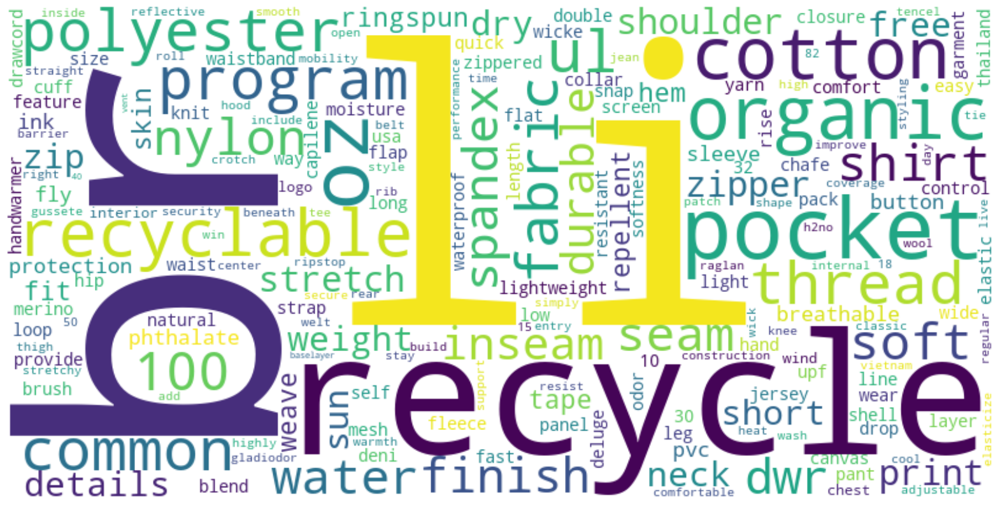

----------------
Wordcloud for  #topic_2


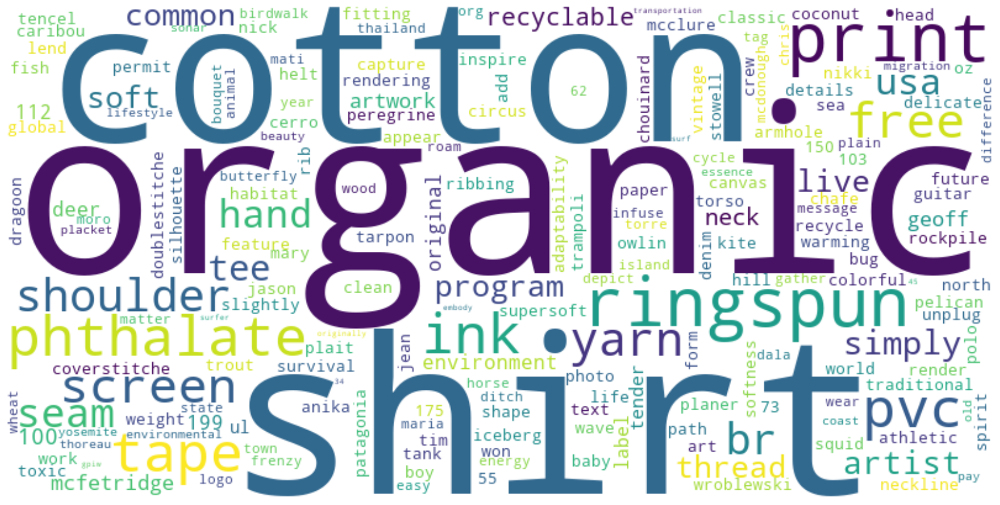

----------------
Wordcloud for  #topic_3


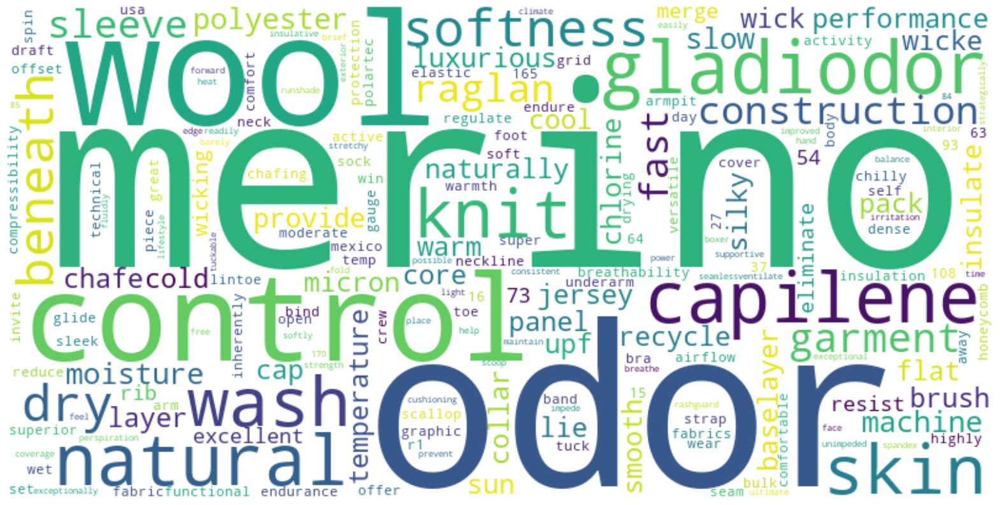

----------------
Wordcloud for  #topic_4


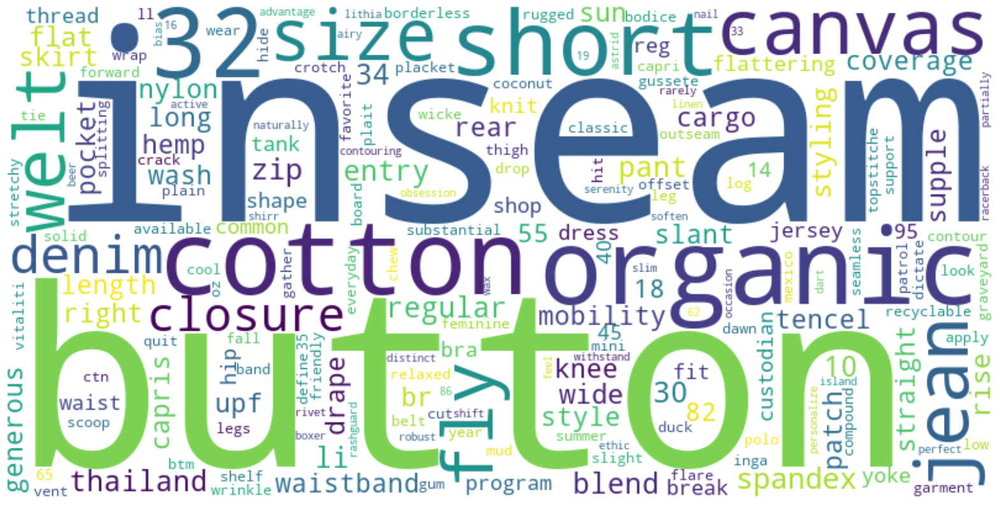

----------------
Wordcloud for  #topic_5


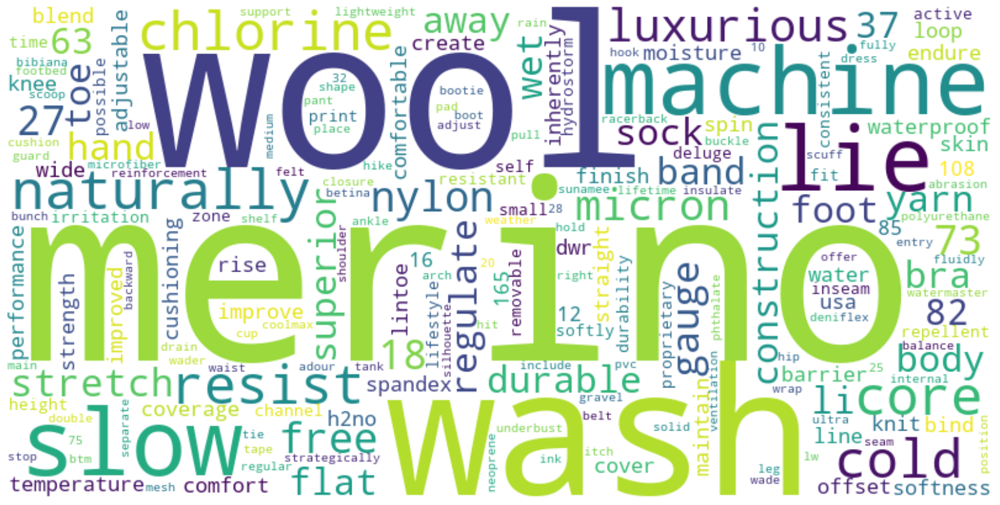

----------------
Wordcloud for  #topic_6


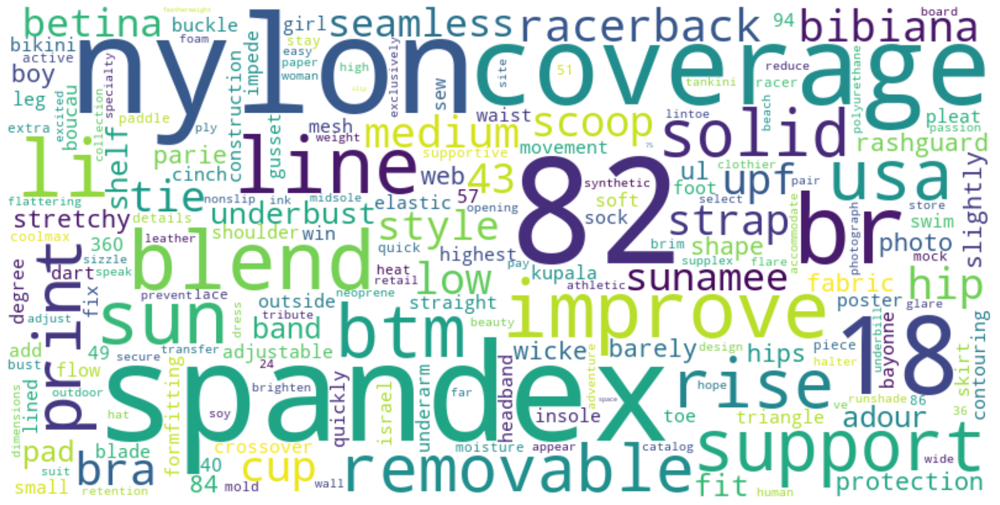

----------------
Wordcloud for  #topic_7


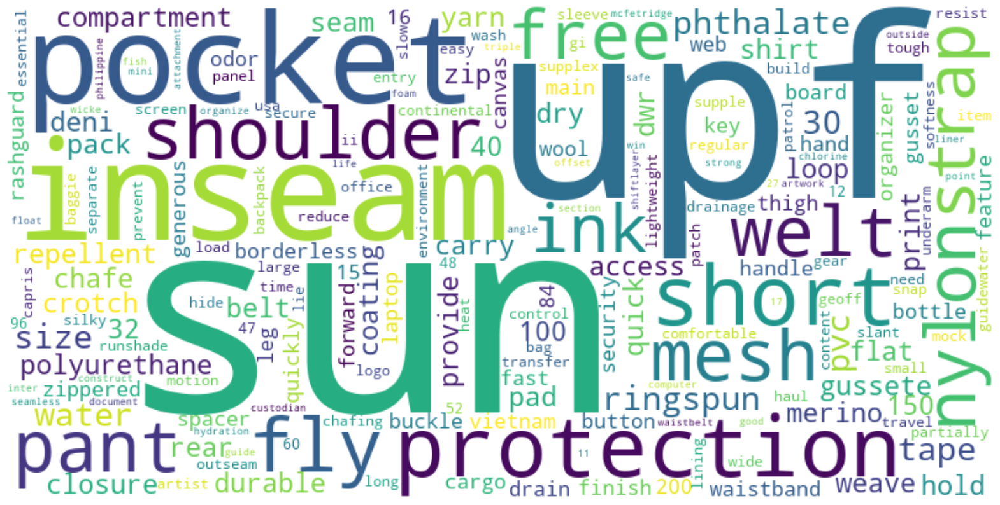

----------------
Wordcloud for  #topic_8


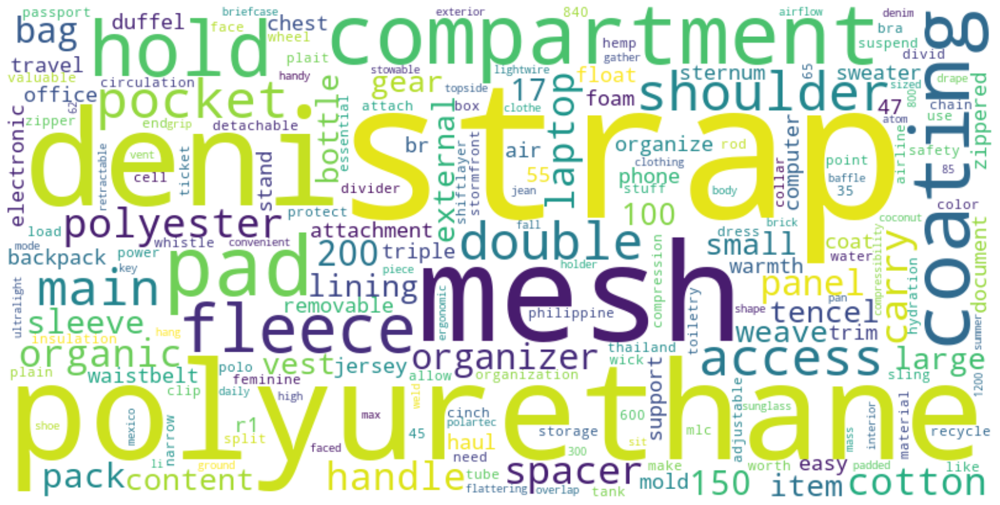

----------------
Wordcloud for  #topic_9


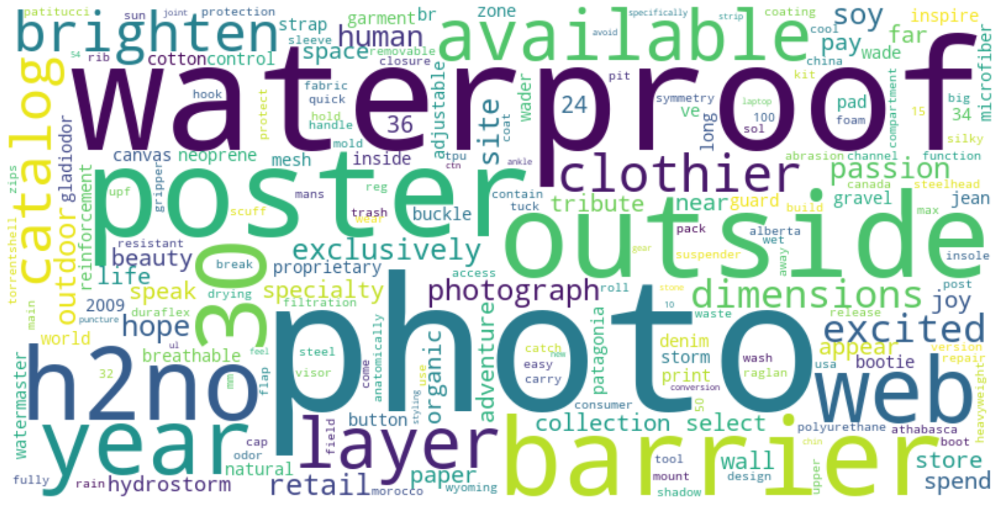

----------------
Wordcloud for  #topic_10


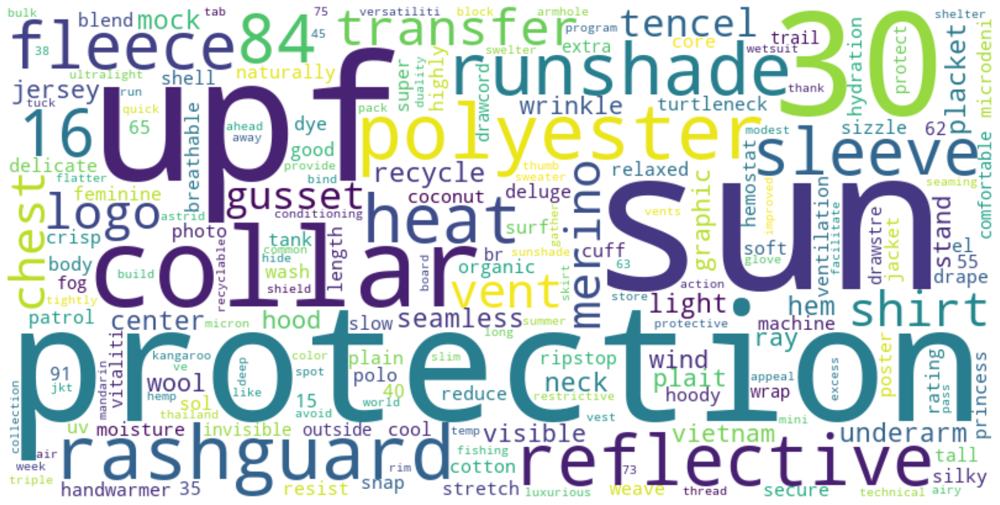

----------------
Wordcloud for  #topic_11


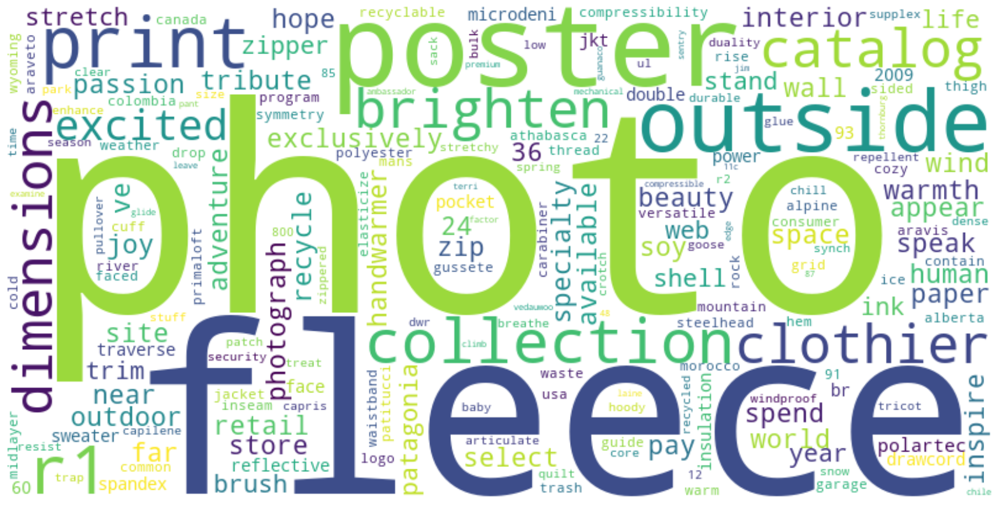

----------------
Wordcloud for  #topic_12


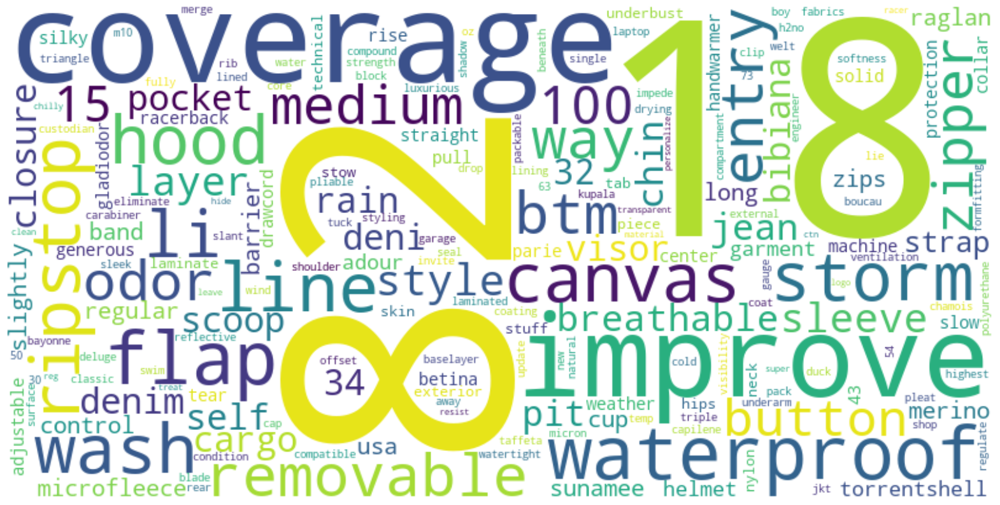

----------------
Wordcloud for  #topic_13


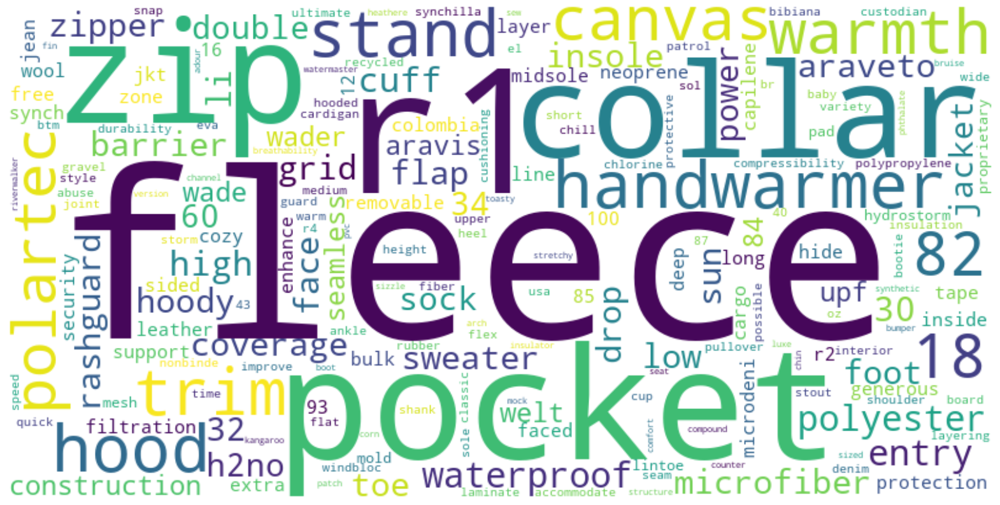

----------------
Wordcloud for  #topic_14


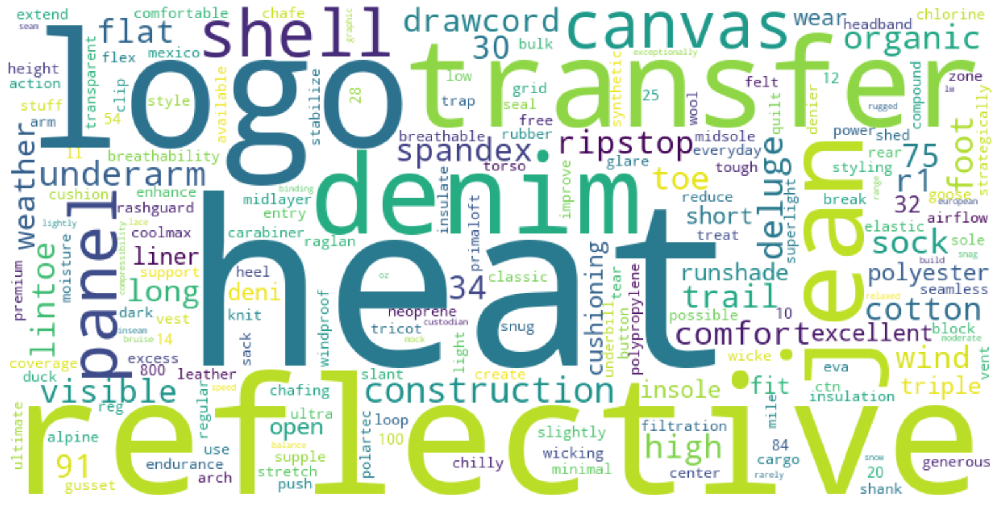

----------------
Wordcloud for  #topic_15


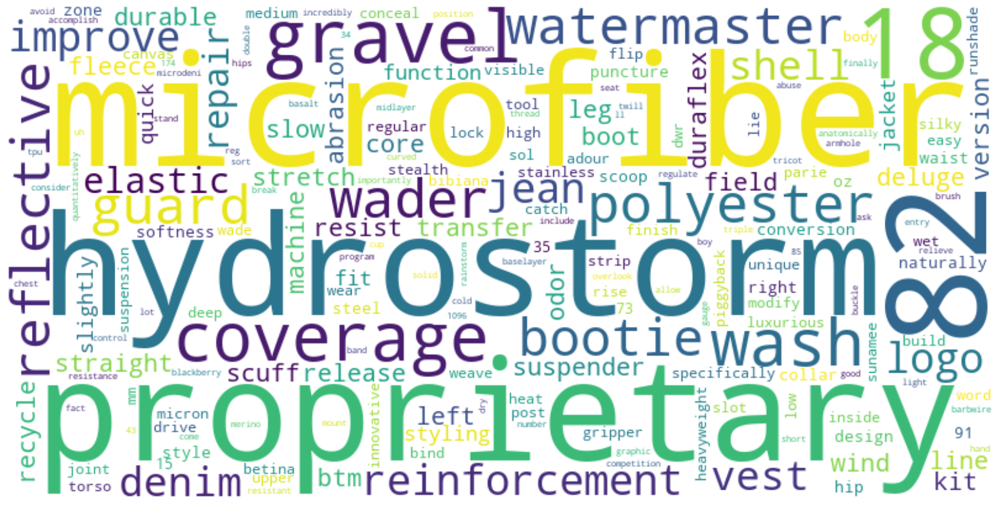

----------------
Wordcloud for  #topic_16


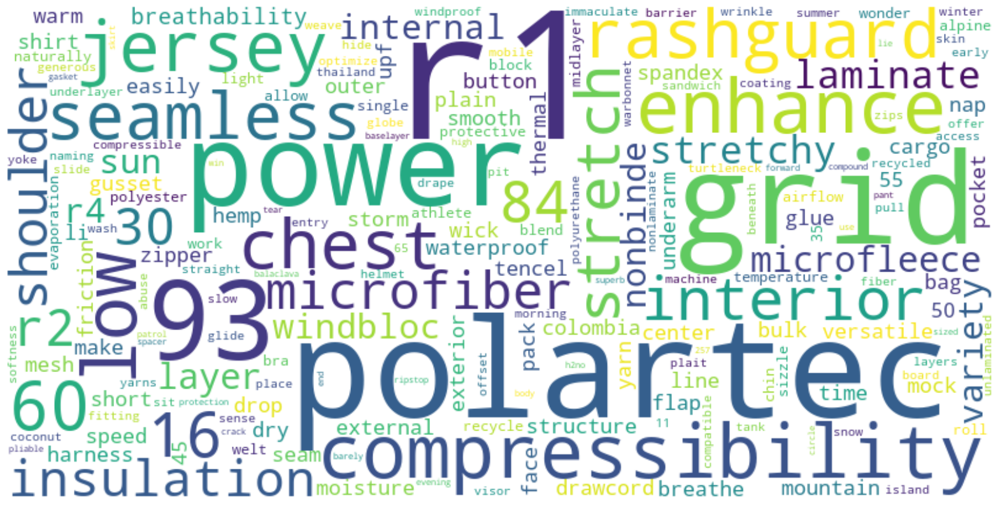

----------------
Wordcloud for  #topic_17


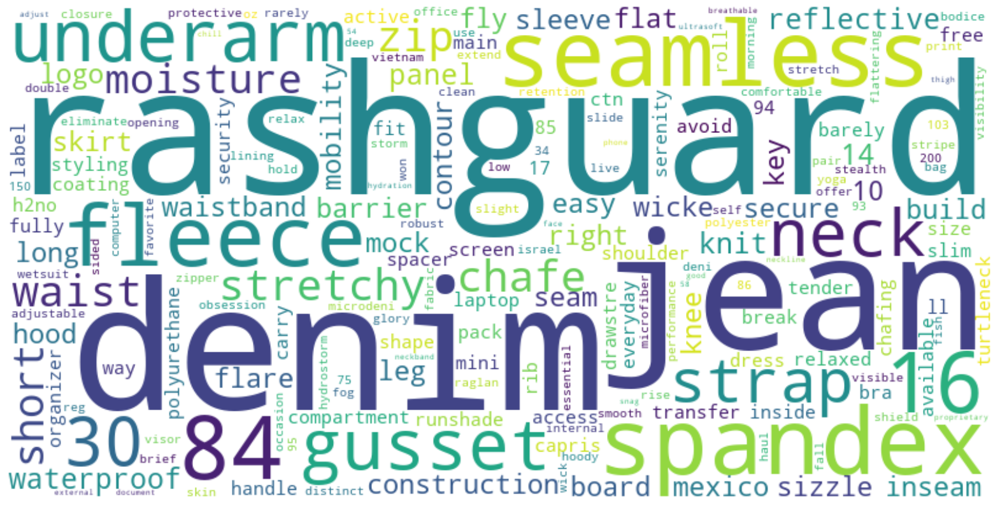

----------------
Wordcloud for  #topic_18


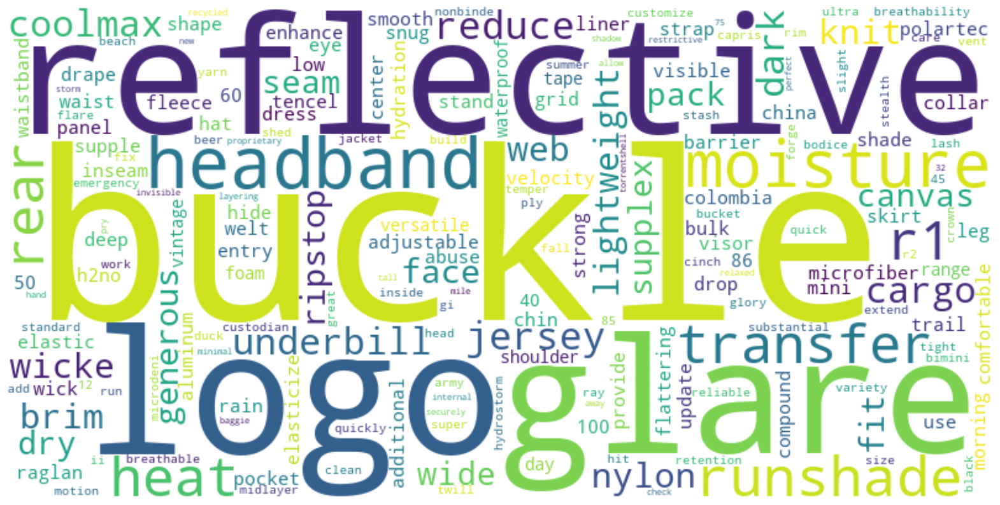

----------------
Wordcloud for  #topic_19


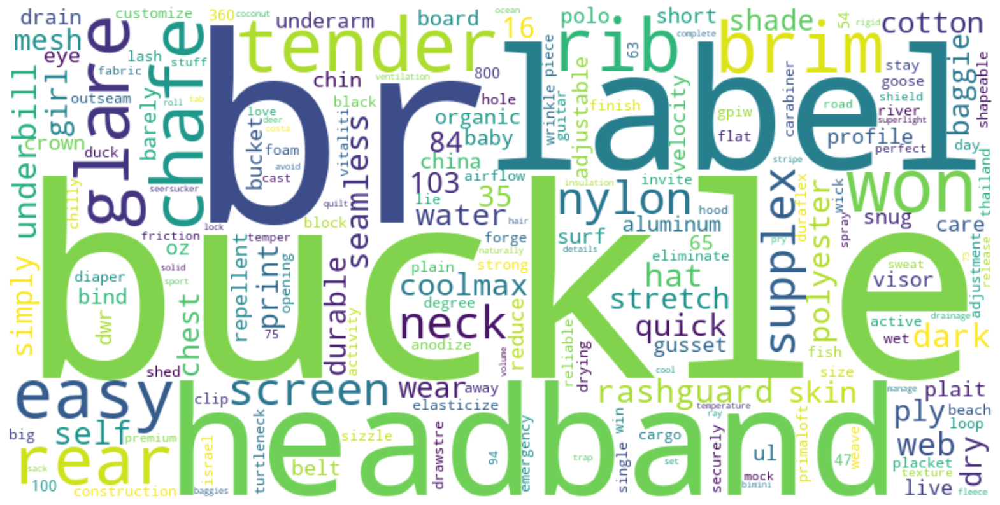

----------------
Wordcloud for  #topic_20


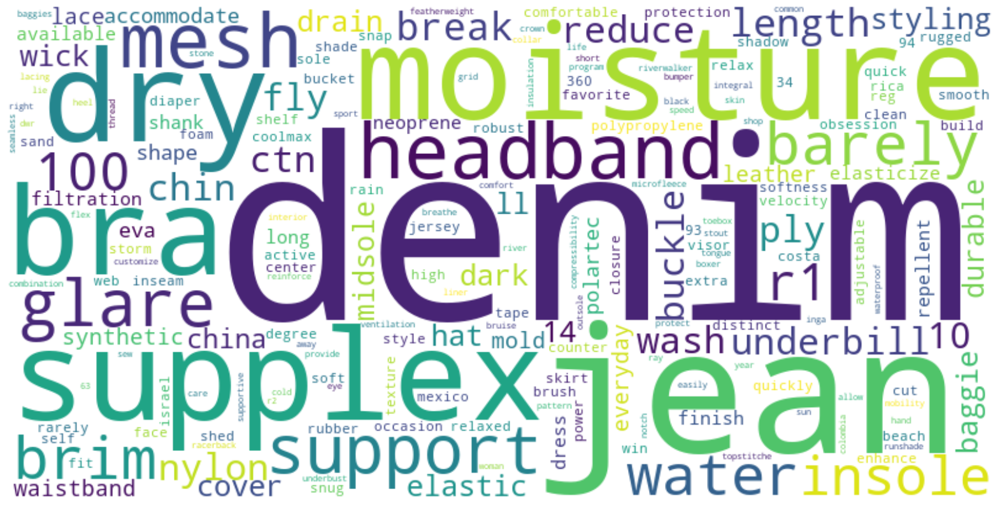

In [288]:
from wordcloud import WordCloud

for column in  ["topic_{}".format(i+1) for i in range(20)]:
    word_freq = topic_t[column].to_dict()

    cloud  = WordCloud(background_color="white", contour_width=1, contour_color='steelblue',width=800, height=400).generate_from_frequencies(word_freq)
    #no stop words as it is ignored when using from_frequencies

    print("----------------")
    print('Wordcloud for  #{}'.format(column))

    # Show plot
    plt.figure(figsize=(20, 20))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [271]:
columns

't'